In [2]:
# Imports
import numpy as np
import scipy.ndimage as ndi
import PIL
import skimage as ski

import matplotlib.pyplot as plt
import plotly.graph_objects as go
import plotly.express as px
from plotly.subplots import make_subplots

# 1. Classical computer vision techniques.
Try these before reaching for a machine learning model. Non-ML techniques can get you pretty far, plus they're easier to maintain and update than ML models. If these techniques fail, then you have a decent reason to reach for ML.

General data analysis perspectives: 
* It's important to understand how your data is being generated and where your "signal" is coming from. This guides how you should process your data/images to maximise your signal.
* CV is not magic. If you can see the "signal" you're trying to extract, you will be able to detect it with CV methods. If you can't, you need a different perspective on your data.

## Image data structures and packages
99% of the time you'll be working with arrays.
Things to pay attention to:
* Data type of array: Usually work with arrays of floats for medical image processing, but using unsigned integers can have advantages for speed and memory consumption.
* Order of your arrays' dimensions. Some programs expect a specific order (e.g. batch, colour, height, width). Suffix your variables to make it easier to work out what arrays you're working with: e.g. `img_bcyx` for a batch of `b` images, with height `y` and width `x`. 

Common packages when working with image data in Python:
* `numpy`: fundamental array library in Python. Operates only on the CPU. scipy's ndimage, OpenCV, and scikit-image use numpy arrays. 
* `pytorch` / `tensorflow`: tensors == arrays. Can operate on CPU or GPU. Use whichever platform your organisation already uses, but things are generally trending towards pytorch (majority of research papers are first implemented in pytorch).

### Basics

In [3]:
# Create a numpy array with a specific shape and data type
SIZE_X, SIZE_Y = (11, 11)
array_yx = np.zeros((SIZE_Y, SIZE_X), dtype=np.float32)
array_yx[SIZE_Y//2, SIZE_X//2] = 1
array_yx[SIZE_Y//4, SIZE_X//4] = 1

print(f"Shape: {array_yx.shape}")
print(f"Data type: {array_yx.dtype}")

px.imshow(array_yx)

Shape: (11, 11)
Data type: float32


Convolutions (applying filters)

In [4]:
# 1D convolutions
# Slide kernel over image. Multiply kernel with subset of image. Set the pixel to the sum of the result.
# Consider what "mode" is appropriate for your use case
kernel_x = np.ones(3)

result_yx = ndi.convolve1d(array_yx, kernel_x, axis=1)
px.imshow(result_yx)

In [5]:
# 2D convolutions are the same, but with a 2D kernel.
kernel_yx = np.ones((3, 3))
result_yx = ndi.convolve(array_yx, kernel_yx)
px.imshow(result_yx)

In [6]:
%%timeit
# 2D convolutions can be slow.
kernel_yx = np.ones((7, 7))
result_yx = ndi.convolve(array_yx, kernel_yx)

29.1 μs ± 562 ns per loop (mean ± std. dev. of 7 runs, 10,000 loops each)


In [7]:
%%timeit
# But applying 2x 1D convolutions can be faster
# For kernel size (k, k) and image size (N, N), then 2D convolution is O(k^2 N^2)
# But 2x 1D convolutions is O(2k N^2)
# Note this only works if your kernel is "separable": i.e. kernel_yx = convolve(kernel_x, kernel_y)
kernel_x = np.ones(7)
result_yx = ndi.convolve1d(array_yx, kernel_x, axis=0)
result_yx = ndi.convolve1d(result_yx, kernel_x, axis=1)

12.1 μs ± 178 ns per loop (mean ± std. dev. of 7 runs, 100,000 loops each)


Design your processing pipelines with performance in mind.

In [8]:
%%timeit
## Avoid loops and iteration wherever possible.
sum_arr = 0
for i in range(SIZE_X):
    for j in range(SIZE_Y):
        sum_arr += array_yx[j, i]

15.4 μs ± 212 ns per loop (mean ± std. dev. of 7 runs, 100,000 loops each)


In [9]:
%%timeit
## Use vectors / matrix operations instead if possible.
sum_arr = np.sum(array_yx)

1.95 μs ± 18.7 ns per loop (mean ± std. dev. of 7 runs, 100,000 loops each)


### Edge detection
Useful for determining borders between regions; e.g. edges of a road, boundaries of a sports field.

In [10]:
# Load an example image
img = PIL.Image.open("./assets/cat.png")

# convert to greyscale, numpy array
img_yx = np.array(img.convert("L"), dtype=float)
px.imshow(img_yx, color_continuous_scale="Greys_r")

In [11]:
# Apply a gradient filter (e.g. sobel)
xaxis_grad_kernel_yx = np.array([
    [-1, 0, 1],
    [-2, 0, 2],
    [-1, 0, 1],
])
yaxis_grad_kernel_yx = np.array([
    [1, 2, 1],
    [0, 0, 0],
    [-1, -2, -1],
])

gradx_img_yx = ndi.convolve(img_yx, xaxis_grad_kernel_yx)
grady_img_yx = ndi.convolve(img_yx, yaxis_grad_kernel_yx)

figx = px.imshow(gradx_img_yx, title="X axis gradients")
figy = px.imshow(grady_img_yx, title="Y axis gradients")

figx.show()
figy.show()

In [12]:
# Canny edge detection
# Smooth -> Sobel -> Fancy thresholding

canny_yx = ski.feature.canny(
    img_yx,
    sigma=1,  # size of 2D gaussian convolution applied prior to sobel filter
    low_threshold=np.percentile(img_yx, 10),
    high_threshold=np.percentile(img_yx, 20),
)
px.imshow(canny_yx)

In [13]:
# Varying smoothing impacts the size of features that are detected
lb = np.percentile(img_yx, 10)
ub = np.percentile(img_yx, 20)

fig = make_subplots(cols=3)
for i, sig in enumerate([0.3, 1, 3]):
    canny_yx = ski.feature.canny(img_yx, sigma=sig, low_threshold=lb, high_threshold=ub)
    canny_yx = canny_yx.astype(float)
    fig.add_trace(go.Heatmap(z=canny_yx), row=1, col=i+1)

fig.update_yaxes(autorange="reversed")
fig

### Feature extraction
Useful for pulling out "consistent" regions of an image to then track how they move over time, or to classify different textures or patterns.

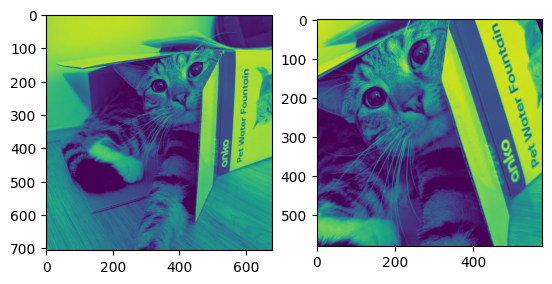

In [55]:
# Matching points across images
# Let's determine the transformation between these two images
def load_image(filepath: str) -> np.ndarray:
    img = PIL.Image.open(filepath)
    img_yx = np.array(img.convert("L"), dtype=float)
    return img_yx


img1_yx = load_image("./assets/cat.png")
img2_yx = load_image("./assets/cat_transform.png")

fig, axs = plt.subplots(ncols=2)
axs[0].imshow(img1_yx)
axs[1].imshow(img2_yx)

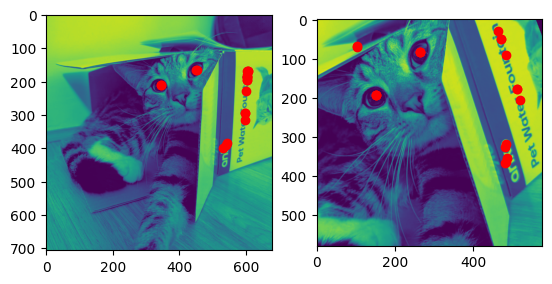

In [56]:
## First extract "corner" points for each image
detector = ski.feature.ORB(n_keypoints=20)

detector.detect_and_extract(img1_yx)
points1 = detector.keypoints
desc1 = detector.descriptors

detector.detect_and_extract(img2_yx)
points2 = detector.keypoints
desc2 = detector.descriptors

fig, axs = plt.subplots(ncols=2)
axs[0].imshow(img1_yx)
axs[0].scatter(x=points1[:, 1], y=points1[:, 0], c="red")
axs[1].imshow(img2_yx)
axs[1].scatter(x=points2[:, 1], y=points2[:, 0], c="red")

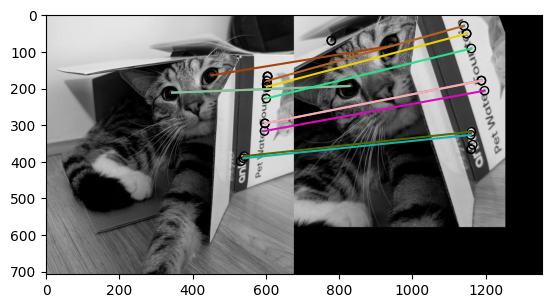

In [58]:
## Match features in each list of points
## There's many ways to do this depending on your dataset and metric for similarity
## A simple exhaustive search works in some cases
matches = ski.feature.match_descriptors(desc1, desc2, metric="euclidean", cross_check=True)
fig, ax = plt.subplots()
ski.feature.plot_matched_features(
    image0=img1_yx,
    image1=img2_yx,
    keypoints0=points1,
    keypoints1=points2,
    matches=matches,
    ax=ax,
)

<AffineTransform(matrix=
    [[   1.26081406,   -0.47648037,   91.10256893],
     [   0.47464894,    1.26505468, -384.17574541],
     [   0.        ,    0.        ,    1.        ]])>


Text(0.5, 1.0, 'Image 2')

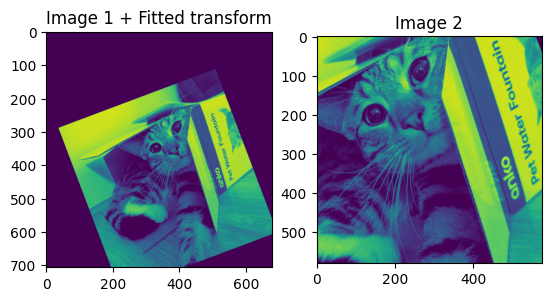

In [85]:
## Fit an affine transform to the matched sets of points
transform = ski.transform.AffineTransform()
img1_matched_points = []
img2_matched_points = []
for idx1, idx2 in matches:
    img1_matched_points.append(points1[idx1])
    img2_matched_points.append(points2[idx2])

transform.estimate(img1_matched_points, img2_matched_points)

## Apply the transform to the original image
img_transformed_yx = ski.transform.warp(img1_yx, inverse_map=transform)
print(transform)
fig, axs = plt.subplots(ncols=2)
axs[0].imshow(img_transformed_yx)
axs[0].set_title("Image 1 + Fitted transform")
axs[1].imshow(img2_yx)
axs[1].set_title("Image 2")


In [88]:
## But random sample consensus (RANSAC) can be a more robust way of doing this
## It is slower as it involves iteratively fitting a model to your data
transform = ski.transform.AffineTransform()
transform_ransac = ski.measure.ransac(
    (np.array(img1_matched_points), np.array(img2_matched_points)),
    ski.transform.AffineTransform,
    residual_threshold=2,
    min_samples=3,
    max_trials=50,
)
print(transform_ransac)  # Same matrix as no points in this example are outliers

(<AffineTransform(matrix=
    [[   1.26081406,   -0.47648037,   91.10256893],
     [   0.47464894,    1.26505468, -384.17574541],
     [   0.        ,    0.        ,    1.        ]]) at 0x2c944c3d4b0>, array([ True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True]))


### Optical flow
Optical flow aims to track the motion of objects between consecutive images or frames in a video. This motion can be caused by the object moving and/or the camera moving. 

Two main types: dense and sparse. 

Dense optical flow returns a position estimate for every individual pixel via a leaat-squares fit, assuming the intensities of pixels of the same object remain constant.

Sparse optical flow aims to track the position of a subset of your image (either important pixels i.e.: "corners", or small patches of images "super pixels"). Typically this is done to reduce computational complexity. 

### Object detection

e.g. Face detection via Viola-Jones algorithm. Combination of selection of simple filter kernels (Haar feature detectors) based on human intuition. They then train a binary classification model (AdaBoost) on the outputs of the feature detectors to determine if a specific image contains a face.

### Handling images at multiple scales

Not all features within images will be at the same scale. A common method to handle this are image pyramids, where the image is blurred and subsampled by factors of 2 to lower and lower resolutions. 
The algorithms above are then run over all layers of pyramid. 

This then requires consideration of how the outputs from each layer are combined to produce a single result. Commonly this is either a vote/consensus based on some error metric. Alternatively they can be applied sequentially starting with the lower resolution, with the higher resolution layers aiming to refine the predictions from previous levels.

### Kalman filters

Can come in very handy, particularly with object tracking pipelines. 

A very thorough tutorial on Kalman filters: https://github.com/rlabbe/Kalman-and-Bayesian-Filters-in-Python

A nice example of how they've been integrated into a complex image tracking pipeline: https://github.com/yangchris11/samurai